In [204]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

In [205]:
df_train = pd.read_csv("data/train.csv").set_index("id")
df_test = pd.read_csv("data/test.csv").set_index("id")
df_submission = pd.read_csv("data/sample_submission.csv")

df_train.head()

,brand,model,model_year,milage,fuel_type,engine,transmission,ext_col,int_col,accident,clean_title,price
id,,,,,,,,,,,,
0,Ford,F-150 Lariat,2018,74349,Gasoline,375.0HP 3.5L V6 Cylinder Engine Gasoline Fuel,10-Speed A/T,Blue,Gray,None reported,Yes,11000
1,BMW,335 i,2007,80000,Gasoline,300.0HP 3.0L Straight 6 Cylinder Engine Gasoli...,6-Speed M/T,Black,Black,None reported,Yes,8250
2,Jaguar,XF Luxury,2009,91491,Gasoline,300.0HP 4.2L 8 Cylinder Engine Gasoline Fuel,6-Speed A/T,Purple,Beige,None reported,Yes,15000
3,BMW,X7 xDrive40i,2022,2437,Hybrid,335.0HP 3.0L Straight 6 Cylinder Engine Gasoli...,Transmission w/Dual Shift Mode,Gray,Brown,None reported,Yes,63500
4,Pontiac,Firebird Base,2001,111000,Gasoline,200.0HP 3.8L V6 Cylinder Engine Gasoline Fuel,A/T,White,Black,None reported,Yes,7850


In [206]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 54273 entries, 0 to 54272
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   brand         54273 non-null  object
 1   model         54273 non-null  object
 2   model_year    54273 non-null  int64 
 3   milage        54273 non-null  int64 
 4   fuel_type     54273 non-null  object
 5   engine        54273 non-null  object
 6   transmission  54273 non-null  object
 7   ext_col       54273 non-null  object
 8   int_col       54273 non-null  object
 9   accident      54273 non-null  object
 10  clean_title   54273 non-null  object
 11  price         54273 non-null  int64 
dtypes: int64(3), object(9)
memory usage: 5.4+ MB


## Understand Data

count    5.427300e+04
mean     3.921844e+04
std      7.282634e+04
min      2.000000e+03
25%      1.550000e+04
50%      2.800000e+04
75%      4.500000e+04
max      2.954083e+06
Name: price, dtype: float64


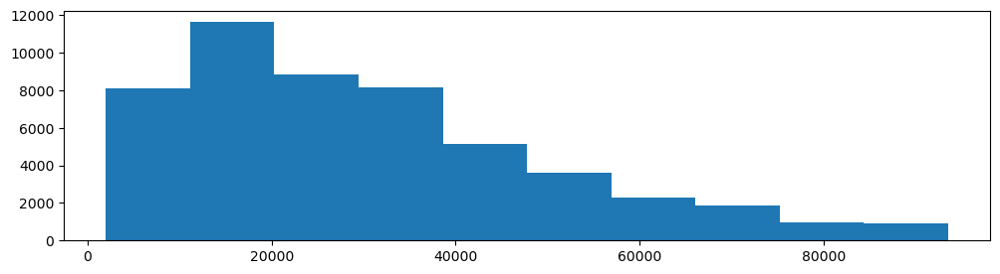

In [207]:
print(df_train.price.describe())

# df_train.price.quantile(0.9)
plt.figure(figsize = (12,3))
plt.hist(df_train.loc[df_train.price < df_train.price.quantile(0.95), "price"]);

In [208]:
df_train.loc[df_train.price > df_train.price.quantile(0.95)].groupby("brand")['price'].min().sort_values(ascending= False)

brand
Hummer           2954083
Bugatti          1950995
Subaru            210000
Pontiac           209995
Honda             148500
Buick             144664
Chrysler          131000
Mazda             123999
Scion             119900
Volvo             110000
Hyundai           104000
Tesla             103500
Lucid              99950
Mitsubishi         98900
Volkswagen         97952
Alfa               97500
Genesis            96850
RAM                96500
Ferrari            96500
Aston              96000
Maserati           95999
Acura              95580
Nissan             95000
MINI               94999
GMC                94995
Kia                94995
Toyota             94900
Lincoln            94500
Dodge              94000
Bentley            94000
Rolls-Royce        94000
Rivian             94000
Lamborghini        94000
McLaren            94000
Land               94000
INFINITI           94000
Lexus              94000
Ford               93999
Jeep               93999
Mercedes-Benz      

In [209]:
# Brand
print(df_train.brand.drop_duplicates().shape)
df_train.brand.value_counts().head()

(53,)


brand
BMW              7369
Ford             6706
Mercedes-Benz    5087
Chevrolet        4424
Audi             2922
Name: count, dtype: int64

In [210]:
x = (df_train.groupby("brand")["price"].mean() - df_train.price.mean())/df_train.price.std()
x[x.abs() > 0.5]

brand
Aston           1.080205
Bentley         0.906174
Bugatti        26.251171
Ferrari         1.636577
Lamborghini     1.449413
Lucid           0.617449
McLaren         0.960591
Rivian          0.553061
Rolls-Royce     1.265293
Name: price, dtype: float64

C:\Users\garim\anaconda3\envs\github\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



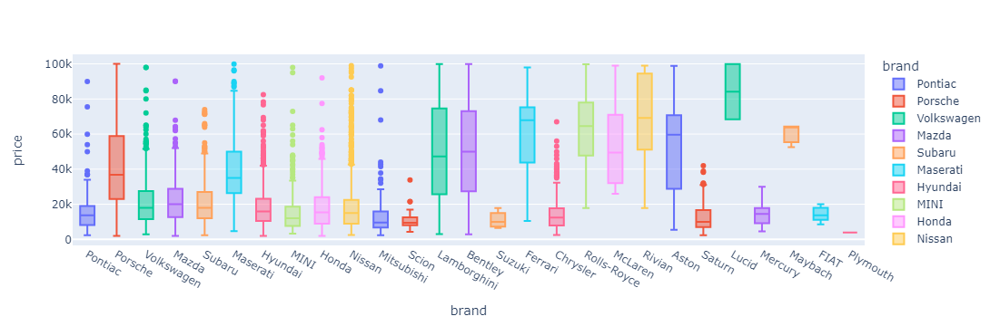

In [211]:
px.box(data_frame= df_train[df_train.brand.isin(x[x.abs() > 0.2].index)].query('price < 1e5'), 
       x= "brand", y= "price", color= "brand")

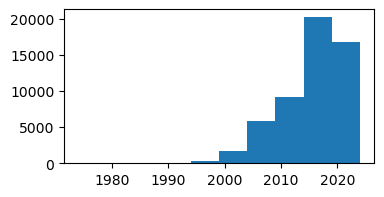

In [212]:
# Model Year
plt.figure(figsize= (4,2))
plt.hist(df_train["model_year"]);

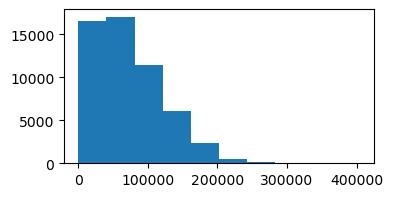

In [213]:
# Mileage
plt.figure(figsize= (4,2))
plt.hist(df_train["milage"]);

In [214]:
# Fuel Type
df_train.fuel_type.value_counts()

fuel_type
Gasoline          49439
Hybrid             1766
E85 Flex Fuel      1479
Diesel             1109
–                   294
Plug-In Hybrid      182
not supported         4
Name: count, dtype: int64

C:\Users\garim\anaconda3\envs\github\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



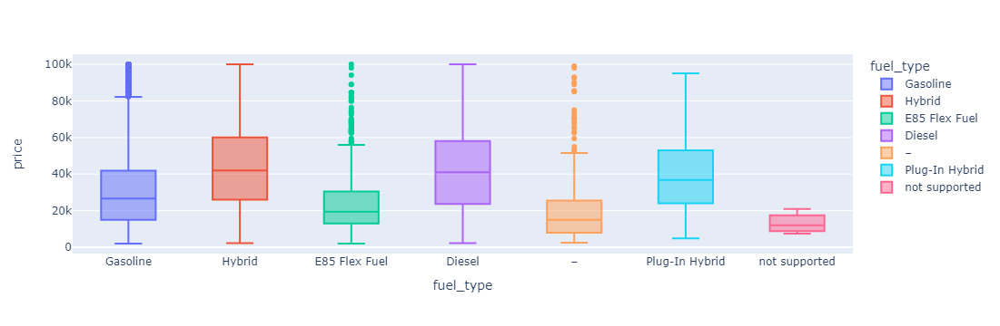

In [215]:
px.box(data_frame= df_train.query("price < 1e5"), x= "fuel_type", y= "price", color= "fuel_type")

In [216]:
# Engine
res_engine = df_train["engine"].value_counts()
res_engine

engine
300.0HP 3.0L Straight 6 Cylinder Engine Gasoline Fuel    1452
355.0HP 5.3L 8 Cylinder Engine Gasoline Fuel             1125
240.0HP 2.0L 4 Cylinder Engine Gasoline Fuel             1054
285.0HP 3.6L V6 Cylinder Engine Gasoline Fuel             979
420.0HP 6.2L 8 Cylinder Engine Gasoline Fuel              893
                                                         ... 
4.4 Liter GDI DOHC Twin Turbo                               1
3.0 Liter Twin Turbo                                        1
150.0HP 2.0L 4 Cylinder Engine Diesel Fuel                  1
266.0HP Electric Motor Electric Fuel System                 1
151.0HP Electric Motor Hydrogen Fuel                        1
Name: count, Length: 1061, dtype: int64

C:\Users\garim\anaconda3\envs\github\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



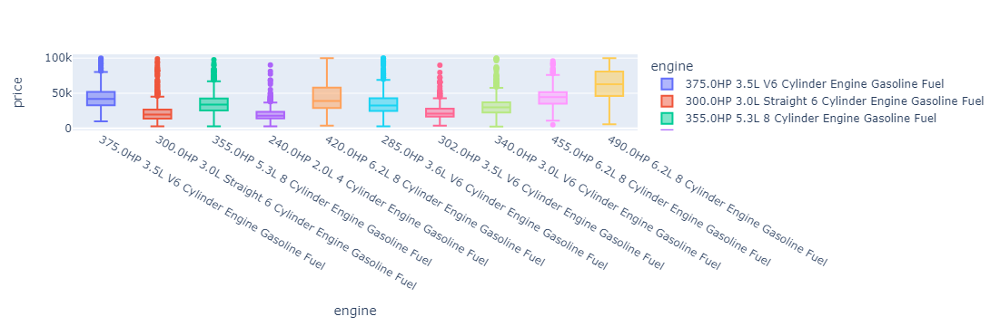

In [217]:
px.box(data_frame= df_train[df_train.engine.isin(res_engine.head(10).index.tolist())].query("price < 1e5"), 
       x= "engine", y= "price", color= "engine")

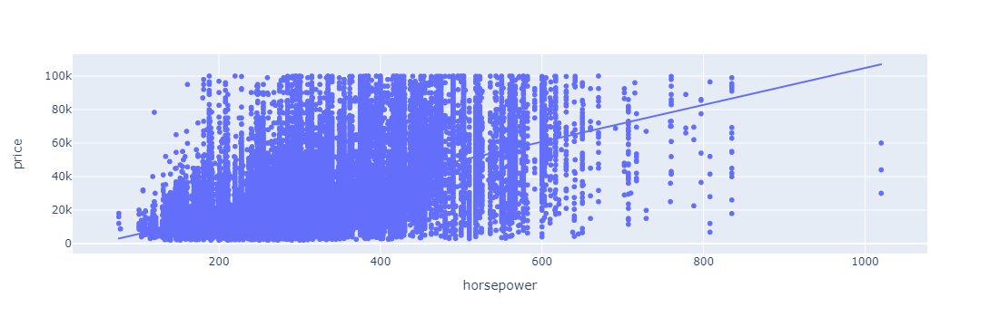

In [218]:
df_train['horsepower'] = pd.to_numeric(df_train['engine'].apply(lambda x: x.split("HP")[0]), errors= 'coerce')
df_train['capacity'] = pd.to_numeric(df_train['engine'].apply(lambda x: x.split("L ")[0][-3:] if "L " in x else ''), errors= 'coerce')
# df_train[df_train.horsepower.isna()]
px.scatter(data_frame= df_train.query('price < 1e5'), x= "horsepower", y= "price", trendline= 'ols')

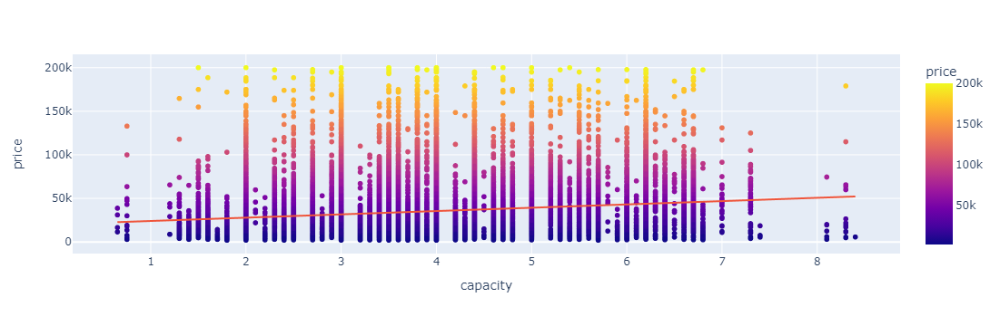

In [219]:
px.scatter(data_frame= df_train.query('price < 2e5'), x= "capacity", y= "price", trendline= 'ols', color= "price")

In [220]:
# Transmission
df_train["transmission"].value_counts()
df_train['transmission_speed'] = pd.to_numeric(df_train['transmission'].apply(lambda x: x.lower().split('-speed')[0]), errors= 'coerce')

df_train[df_train.transmission_speed.isna()]

,brand,model,model_year,milage,fuel_type,engine,transmission,ext_col,int_col,accident,clean_title,price,horsepower,capacity,transmission_speed
id,,,,,,,,,,,,,,,
3,BMW,X7 xDrive40i,2022,2437,Hybrid,335.0HP 3.0L Straight 6 Cylinder Engine Gasoli...,Transmission w/Dual Shift Mode,Gray,Brown,None reported,Yes,63500,335.0,3.0,NaN
4,Pontiac,Firebird Base,2001,111000,Gasoline,200.0HP 3.8L V6 Cylinder Engine Gasoline Fuel,A/T,White,Black,None reported,Yes,7850,200.0,3.8,NaN
10,Maserati,Quattroporte S Q4 GranLusso,2018,34920,Gasoline,405.0HP 3.0L V6 Cylinder Engine Gasoline Fuel,A/T,Silver,Black,None reported,Yes,124995,405.0,3.0,NaN
11,Chevrolet,Tahoe Premier,2017,92728,Gasoline,355.0HP 5.3L 8 Cylinder Engine Gasoline Fuel,A/T,Silver,Silver,None reported,Yes,49900,355.0,5.3,NaN
12,Porsche,Cayenne S,2014,112000,Gasoline,300.0HP 3.6L V6 Cylinder Engine Gasoline Fuel,A/T,Silver,Black,None reported,Yes,40000,300.0,3.6,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54262,Jeep,Grand Cherokee Laredo,2011,98658,Gasoline,360.0HP 5.7L 8 Cylinder Engine Gasoline Fuel,A/T,White,Gray,None reported,Yes,7200,360.0,5.7,NaN
54263,BMW,M6 Base,2015,18651,Gasoline,560.0HP 4.4L 8 Cylinder Engine Gasoline Fuel,Transmission w/Dual Shift Mode,White,Black,None reported,Yes,60500,560.0,4.4,NaN
54265,BMW,X7 xDrive40i,2023,9200,Hybrid,335.0HP 3.0L Straight 6 Cylinder Engine Gasoli...,A/T,White,Brown,At least 1 accident or damage reported,Yes,51500,335.0,3.0,NaN


C:\Users\garim\anaconda3\envs\github\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



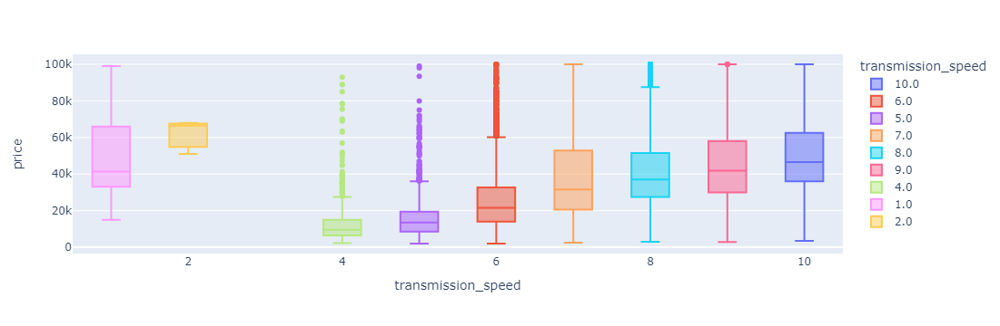

In [221]:
px.box(data_frame= df_train.query('price < 1e5'), x= "transmission_speed", y= "price", color= "transmission_speed")

C:\Users\garim\anaconda3\envs\github\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



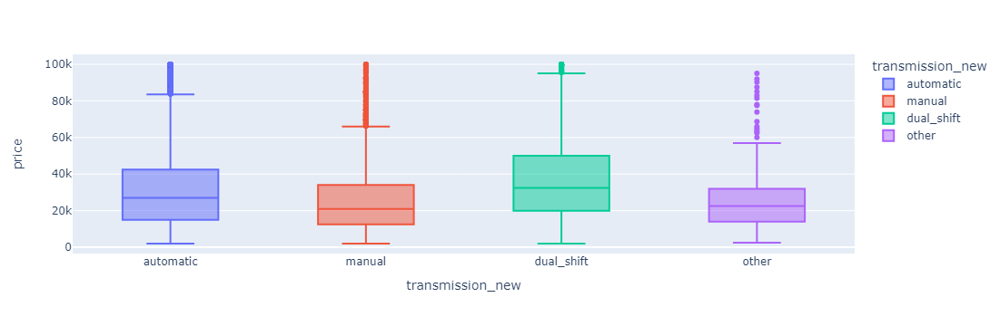

In [222]:
df_train.loc[df_train.transmission.str.lower().str.contains("automatic") | 
    df_train.transmission.str.lower().str.contains("a/t"), "transmission_new"] = "automatic"
df_train.loc[df_train.transmission.str.lower().str.contains("manual") | 
    df_train.transmission.str.lower().str.contains("m/t"), "transmission_new"] = "manual"
df_train.loc[df_train.transmission.str.lower().str.contains("dual shift"), "transmission_new" ] = "dual_shift"
df_train['transmission_new'] = df_train['transmission_new'].fillna('other')

px.violin(data_frame= df_train.query("price < 1e5"), x= "transmission_new", y= "price", color= "transmission_new")

In [224]:
# external color
print(df_train.ext_col.value_counts())
top_ext_col = df_train.ext_col.value_counts().head(10).index.tolist()

ext_col
Black                      15078
White                      13422
Gray                        7909
Silver                      5161
Blue                        4668
                           ...  
Balloon White                  1
Firenze Red Metallic           1
Orca Black Metallic            1
Radiant Red Metallic II        1
Magnetic Gray Clearcoat        1
Name: count, Length: 260, dtype: int64


C:\Users\garim\anaconda3\envs\github\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



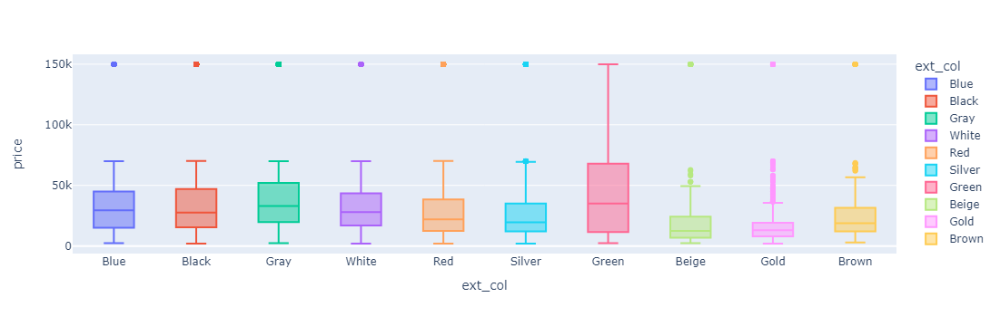

In [225]:
tmp_df= df_train.query(f"ext_col in {top_ext_col}")
tmp_df.loc[tmp_df.price >= df_train.price.quantile(0.9), "price"] = df_train.price.quantile(0.98)
px.box(data_frame= tmp_df, x= "ext_col", y= "price", color= "ext_col")

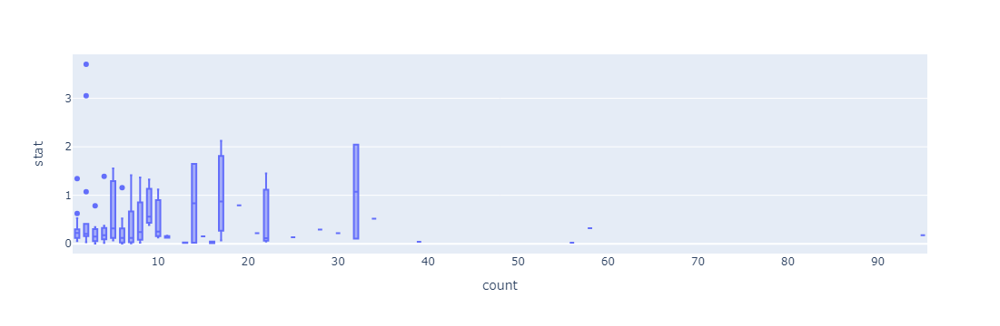

In [248]:
import numpy as np
dt_int = df_train.groupby('int_col').agg({'price': [lambda x: np.abs(x.mean() - df_train.price.mean())/df_train.price.std(), 'count']} )
dt_int.columns = ['stat','count']
# dt_int[dt_int.stat.abs() > 1]
px.box(data_frame= dt_int.query('count < 100'), x= "count", y= "stat")

C:\Users\garim\anaconda3\envs\github\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



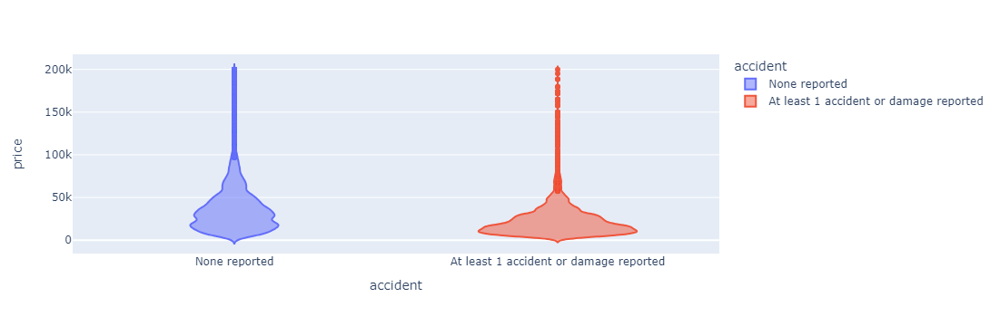

In [226]:
# Accident
# limit to less than 100k prices to visualize better
px.violin(data_frame= df_train.query("price < 2e5"), x= "accident", y= "price", color= "accident")

In [227]:
# Clean Title
df_train.clean_title.value_counts()

clean_title
Yes    54273
Name: count, dtype: int64

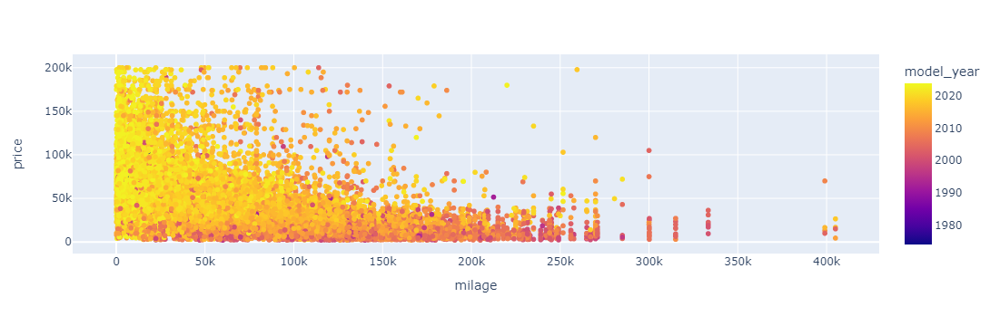

In [228]:
px.scatter(data_frame= df_train.query("price < 2e5"), x= "milage", y= "price", color = "model_year")

In [229]:
df_train[df_train.model.isin(df_train.groupby("model")['price'].median().sort_values(ascending= False).head(10).index.tolist())]

,brand,model,model_year,milage,fuel_type,engine,transmission,ext_col,int_col,accident,clean_title,price,horsepower,capacity,transmission_speed,transmission_new
id,,,,,,,,,,,,,,,,
903,McLaren,720S Performance,2018,66250,Gasoline,4.0L V8 32V MPFI DOHC Twin Turbo,7-Speed Automatic with Auto-Shift,Black,Black,None reported,Yes,40995,NaN,4.0,7.0,automatic
2094,Lamborghini,Huracan EVO Base,2020,2165,Gasoline,5.2L V12 48V GDI DOHC Twin Turbo,7-Speed Automatic with Auto-Shift,Black,Black,None reported,Yes,279950,NaN,5.2,7.0,automatic
3229,Lamborghini,Huracan EVO Coupe,2020,6246,Gasoline,5.2L V10 40V GDI DOHC,7-Speed Automatic with Auto-Shift,Nero Noctis,Nero Ade,None reported,Yes,279950,NaN,5.2,7.0,automatic
4147,Lamborghini,Huracan EVO Base,2020,6987,Gasoline,5.2L V10 40V GDI DOHC,8-Speed Automatic,Gray,Nero Ade,None reported,Yes,267950,NaN,5.2,8.0,automatic
6905,McLaren,720S Performance,2019,49899,Gasoline,710.0HP 4.0L 8 Cylinder Engine Gasoline Fuel,7-Speed A/T,White,Black,None reported,Yes,30089,710.0,4.0,7.0,automatic
8238,Lamborghini,Huracan EVO Base,2020,257700,Gasoline,5.2L V10 40V GDI DOHC,7-Speed Manual,Nero Noctis,Nero Ade,None reported,Yes,479995,NaN,5.2,7.0,manual
8598,Lamborghini,Huracan EVO Base,2020,255,Gasoline,5.2L V10 40V GDI DOHC,8-Speed Automatic,Gray,Nero Ade,None reported,Yes,279950,NaN,5.2,8.0,automatic
11190,Ferrari,720S Performance,2020,9989,Gasoline,710.0HP 4.0L 8 Cylinder Engine Gasoline Fuel,7-Speed A/T,White,Black,None reported,Yes,324995,710.0,4.0,7.0,automatic
12157,McLaren,720S Performance,2019,19513,Gasoline,4.0L V8 32V MPFI DOHC Twin Turbo,7-Speed Automatic with Auto-Shift,Black,Red,None reported,Yes,279950,NaN,4.0,7.0,automatic


In [261]:
df_test.brand.value_counts()

brand
BMW              4854
Ford             4382
Mercedes-Benz    3265
Chevrolet        2993
Audi             1919
Porsche          1805
Toyota           1574
Lexus            1530
Jeep             1510
Land             1360
Cadillac         1059
Nissan            922
GMC               749
Dodge             705
INFINITI          666
RAM               606
Mazda             528
Lincoln           496
Subaru            492
Jaguar            447
Hyundai           436
Honda             405
Acura             386
Volkswagen        376
Kia               347
Volvo             309
MINI              258
Maserati          182
Bentley           180
Chrysler          178
Genesis           173
Buick             165
Hummer            118
Mitsubishi        114
Pontiac           109
Lamborghini        91
Rolls-Royce        89
Alfa               79
Tesla              71
Ferrari            52
Aston              44
Saturn             36
Scion              34
McLaren            30
Rivian             22
Lotu

In [284]:
df_avg = df_train.groupby(['brand','model'])['price'].agg(['mean','count'])
df_avg_brand = df_train.groupby(['brand'])['price'].mean()

df_train["mean_price"] = df_avg.loc[df_avg['count'] > 5,"mean"].reindex(df_train.set_index(['brand','model']).index).values
df_train.loc[df_train.mean_price.isna(),"mean_price"] = df_avg_brand.reindex(df_train.loc[df_train.mean_price.isna(), "brand"]).values
df_train.loc[df_train.mean_price.isna(), "mean_price"] = df_train.price.mean()


In [294]:
df_test["price"] = df_avg.loc[df_avg['count'] > 5,"mean"].reindex(df_test.set_index(['brand','model']).index).values
df_test.loc[df_test.price.isna(),"price"] = df_avg_brand.reindex(df_test.loc[df_test.price.isna(), "brand"]).values
df_test.loc[df_test.price.isna(), "price"] = df_train.price.mean()

In [302]:
df_test[['price']].round(3).to_csv("data/price_mean_model.csv")

In [301]:
df_test[['price']].round(3).reset_index().info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36183 entries, 0 to 36182
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   id      36183 non-null  int64  
 1   price   36179 non-null  float64
dtypes: float64(1), int64(1)
memory usage: 565.5 KB
